In [1]:
import synapseclient as sc
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import os
import ast
import warnings
from scipy.stats import ttest_ind
import sys
sys.path.append("../Pythonscripts")
import utils
sns.set_style("dark")
warnings.simplefilter("ignore")

In [2]:
def getHealthCodeInfo(syn, synid):
    entity = syn.get(synid)
    df = pd.read_csv(entity["path"], sep = "\t")
    healthcode_subset = "({})".format([i for i in df["healthCode"]]).replace("[", "").replace("]", "")
    filtered_healthcode_df = df[["healthCode", "age", "gender", "PD", "education", "Enter_State", "UTC_offset"]]
    return healthcode_subset, filtered_healthcode_df

## Read Data

In [3]:
syn = sc.login()
feature_path = r"C:\Users\atedi\OneDrive\Documents\pdkit_walking_features.csv"
data = pd.read_csv(feature_path, index_col = 0)
healthcode_subset, filtered_healthcode_df = getHealthCodeInfo(syn, "syn8381056")

Welcome, aryton tediarjo!



# Some Encountered Issues

In [4]:
for feat in [i for i in data.columns if "features" in i]:
    print("Empty filepaths of {}: {}".format(feat, len(data[data[feat] == "EMPTY FILEPATHS" ])))
    
for feat in [i for i in data.columns if "features" in i]:
    print("Empty accelerometer data of {}: {}".format(feat, len(data[data[feat] == "NO ACCELEROMETER DATA"])))

Empty filepaths of accel_outbound_features_x: 19
Empty filepaths of accel_return_features_x: 6464
Empty filepaths of accel_resting_features_x: 117
Empty filepaths of userAccel_outbound_features_x: 19
Empty filepaths of userAccel_return_features_x: 6464
Empty filepaths of userAccel_resting_features_x: 120
Empty filepaths of accel_outbound_features_y: 19
Empty filepaths of accel_return_features_y: 6464
Empty filepaths of accel_resting_features_y: 117
Empty filepaths of userAccel_outbound_features_y: 19
Empty filepaths of userAccel_return_features_y: 6464
Empty filepaths of userAccel_resting_features_y: 120
Empty filepaths of accel_outbound_features_z: 19
Empty filepaths of accel_return_features_z: 6464
Empty filepaths of accel_resting_features_z: 117
Empty filepaths of userAccel_outbound_features_z: 19
Empty filepaths of userAccel_return_features_z: 6464
Empty filepaths of userAccel_resting_features_z: 120
Empty filepaths of accel_outbound_features_AA: 19
Empty filepaths of accel_return_

# Distribution of Processed Files

### Healthcodes Change after Processing

In [5]:
## Number of unique healthcodes in filtered tsv from synapse
print("number of unique healthcodes in filtered tsv dataset: {}".format(len(filtered_healthcode_df["healthCode"].unique())))


## Number of unique healthcodes of feature csv after running through pipeline
temp = pd.merge(filtered_healthcode_df, 
         data[["healthCode"]], 
         how = "inner", on = "healthCode").drop_duplicates().reset_index(drop = True)

print("number of unique healthcodes in processed data: {}".format(len(temp["healthCode"].unique())))

number of unique healthcodes in filtered tsv dataset: 192
number of unique healthcodes in processed data: 192


After processing through the data pipeline, around 20 healthcodes are missing from the previous tsv file, due to dropping null filepaths on a given recordID, here is how much unique healthCodes that this notebook will assess.
As healthcode is being dropped, we will have to check whether the distribution is still age-gender case matched.

### Current PD and Gender Distribution

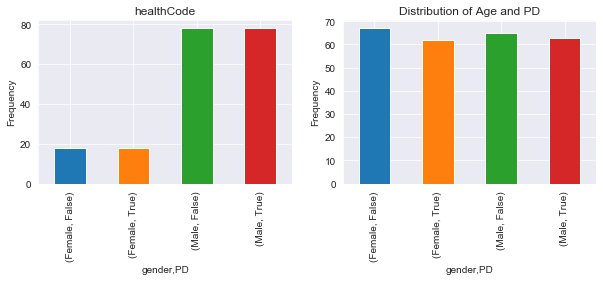

In [6]:
grouped = data.groupby(["gender", "PD"]).agg({"healthCode": lambda x: x.nunique(), "age": np.median})

fig, axes = plt.subplots(nrows=1, ncols=2,figsize=(10,3))


grouped["healthCode"].plot(kind = "bar", ax = axes[0],subplots=True, grid = True)
plt.title("Distribution of Genders and PD")
axes[0].set_ylabel("Frequency")
grouped["age"].plot(kind = "bar", ax = axes[1],subplots=True, grid = True)
plt.title("Distribution of Age and PD")
plt.ylabel("Frequency")


plt.show()

As data is approximately case-matched in terms of gender and their age based on the data above, statistical inferences on the pdkit features can be analyzed.

# Data Preparation

In [41]:
def normalize_dict(params, key):
    try:
        dict_ = ast.literal_eval(params)
    except:
        return np.NaN
    return dict_[key]

def normalize(data):
    for i in [feat for feat in data.columns if "features" in feat]:
        data["no_of_steps {}".format(i)] = data[i].apply(normalize_dict, 
                                                         key = "no_of_steps_")
        data["median_freeze_index {}".format(i)] = data[i].apply(normalize_dict, 
                                                                 key = "median_freeze_index_")
        data["count_freeze_index {}".format(i)] = data[i].apply(normalize_dict, 
                                                                key = "count_freeze_index_")
        data["speed_of_gait {}".format(i)] = data[i].apply(normalize_dict, 
                                                           key = "speed_of_gait_")
        data["gait_step_regularity {}".format(i)] = data[i].apply(normalize_dict, 
                                                                  key = "gait_step_regularity_")
        data["gait_stride_regularity {}".format(i)] = data[i].apply(normalize_dict, 
                                                                    key = "gait_stride_regularity_")
        data["gait_symmetry {}".format(i)] = data[i].apply(normalize_dict, 
                                                           key = "gait_symmetry_")
        data["frequency_of_peaks {}".format(i)] = data[i].apply(normalize_dict, 
                                                                key = "frequency_of_peaks_")
        
        data = data.drop([i], axis = 1)
    return data

def plot_distribution(data):
    for i in [i for i in data.columns if "features" in i]:
        PD = data[data["PD"] == True][i].dropna()
        NONPD = data[data["PD"] == False][i].dropna()
        fig, axes = plt.subplots(nrows=1, ncols=2,figsize=(10,5))
        sns.distplot(PD, label = "PD", kde_kws={"shade": True}, hist = False, ax = axes[0])
        sns.distplot(NONPD, label = "NONPD", kde_kws={"shade": True}, hist = False, ax = axes[0])
        sns.boxplot(x = "PD", y = i, data = data, ax = axes[1], orient = "v", order = [True, False])
        axes[0].set_title("p-values: {}".format(ttest_ind(PD, NONPD)[1]))
        axes[0].grid()
        axes[1].grid()
        plt.show()

### Retrieving Data

In [42]:
walking_columns = [feat for feat in data.columns if ("features" in feat) 
                   and ("outbound" in feat or "return" in feat)]
balance_columns = [feat for feat in data.columns if ("features" in feat) 
                   and (feat not in walking_columns)]
data_no_feature = data[[feat for feat in data.columns if "features" 
                        not in feat]]
walking_data = data[[feat for feat in data.columns if (feat in walking_columns) 
                     or ("healthCode" in feat)]]
balance_data = data[[feat for feat in data.columns if (feat in balance_columns) 
                     or ("healthCode" in feat)]]

#### a. Walking Data (Outbound and Return Combined)

In [43]:
## get subset of data

temp = walking_data

temp = temp.rename(columns = {"accel_return_features_x" : "accel_walking_features_x", 
                              "userAccel_return_features_x" : "userAccel_walking_features_x",
                              "accel_return_features_y" : "accel_walking_features_y", 
                              "userAccel_return_features_y" : "userAccel_walking_features_y",
                              "accel_return_features_z" : "accel_walking_features_z", 
                              "userAccel_return_features_z" : "userAccel_walking_features_z",
                              "accel_return_features_AA" : "accel_walking_features_AA", 
                              "userAccel_return_features_AA" : "userAccel_walking_features_AA"
                             })
walking_data = walking_data.rename(columns = {"accel_return_features_x" : "accel_walking_features_x", 
                              "userAccel_return_features_x" : "userAccel_walking_features_x",
                              "accel_return_features_y" : "accel_walking_features_y", 
                              "userAccel_return_features_y" : "userAccel_walking_features_y",
                              "accel_return_features_z" : "accel_walking_features_z", 
                              "userAccel_return_features_z" : "userAccel_walking_features_z",
                              "accel_return_features_AA" : "accel_walking_features_AA", 
                              "userAccel_return_features_AA" : "userAccel_walking_features_AA"
                             })

## Concatenate return and outbound data
walking_data = pd.concat([walking_data, temp], ignore_index = True)
walking_data = walking_data[[feat for feat in walking_data if ("walking" in feat) or ("healthCode" in feat)]]

#### b. Normalize Dictionary in Data

In [44]:
#### normalize walking data ######

walking_data = normalize(walking_data)
walking_data = pd.merge(walking_data, filtered_healthcode_df, how = "left", on = "healthCode")

In [45]:
### normalize balance data ######

balance_data = normalize(balance_data)
balance_data = pd.merge(balance_data, filtered_healthcode_df, how = "left", on = "healthCode")

In [83]:
walking_data.to_csv(r"C:\Users\atedi\OneDrive\Documents\SageBionetworks\local_data\walking_data.csv")
balance_data.to_csv(r"C:\Users\atedi\OneDrive\Documents\SageBionetworks\local_data\balance_data.csv")

# EDA - RAW

Here are my experimental design processes:
1. Acceleration of return and outbound data will be combined into one dataset to assess test subjects movement
2. Resting will be assessed separately
3. Male and Females will be assessed separately to prevent cofounding effects on distribution
4. T-test between two distributions will be assessed to assess significant differences between PD and NON-PD
5. Conduct tests based on each healthCode performance (grouping by healthcodes)

Remarks:

- There are lots of empty plots due to how balance data is undetectable by the PDKit library, therefore all values are zeroed out.
- PD patient will be indicated as the color blue and NONPD as the color orange.

## 1. Walking Data All

#### Analysis on Male Subjects

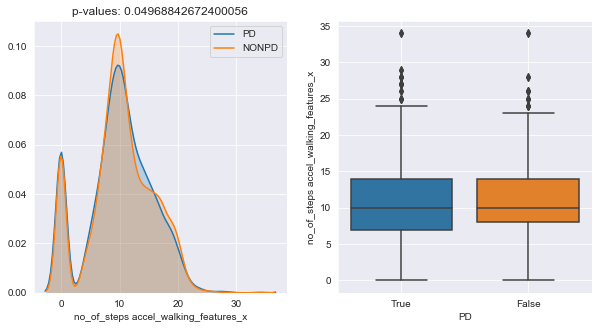

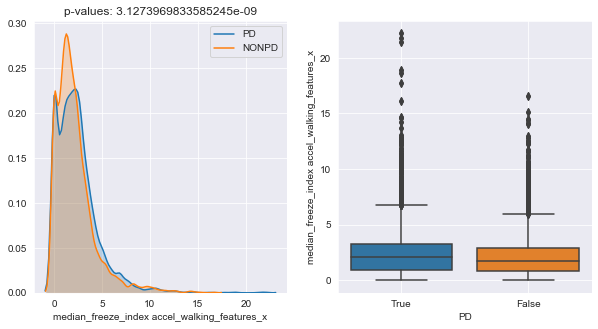

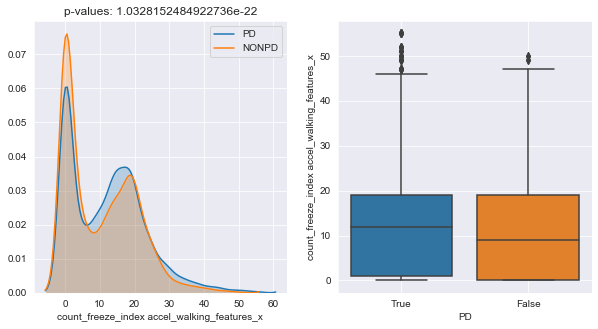

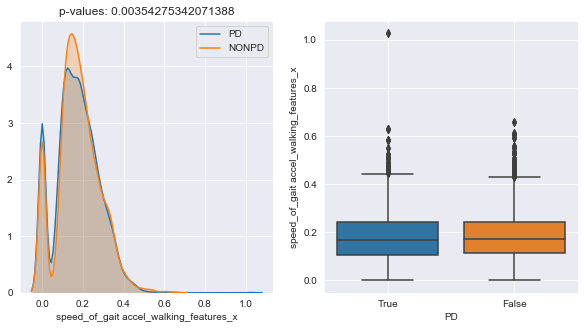

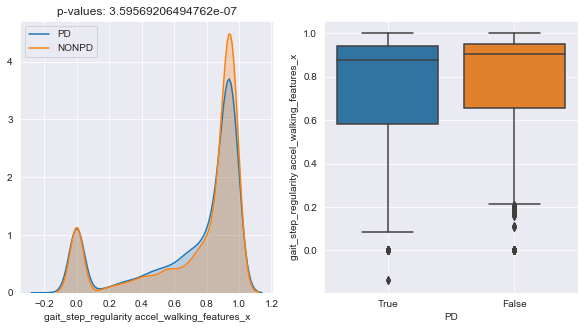

...

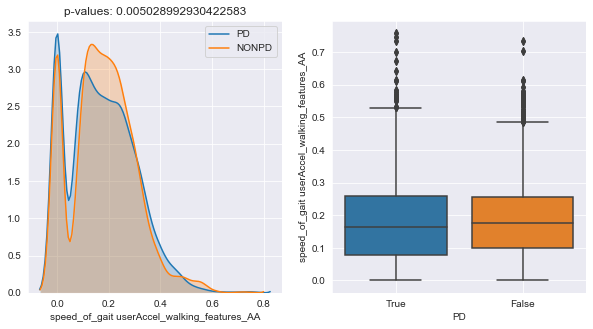

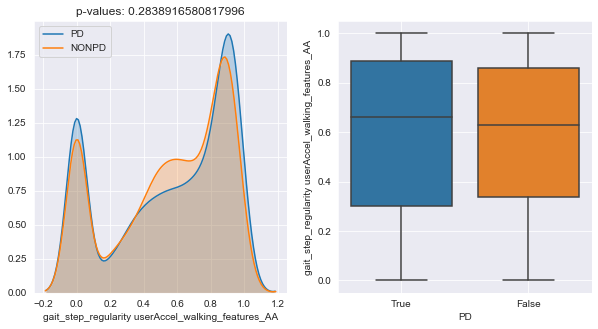

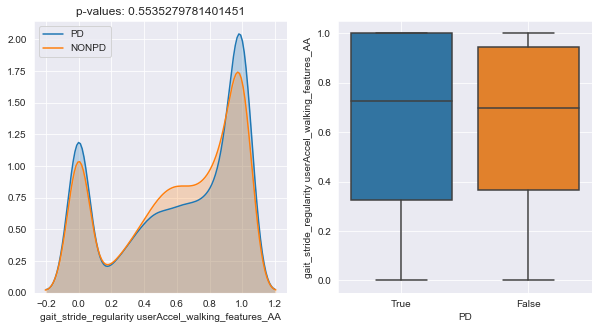

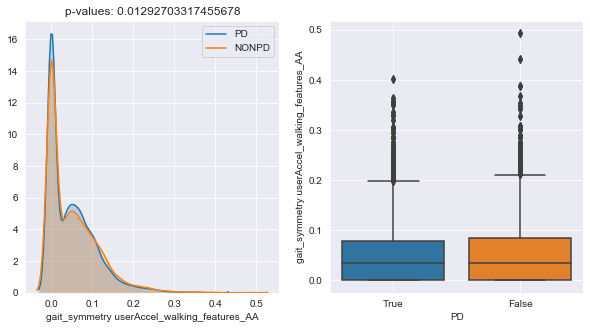

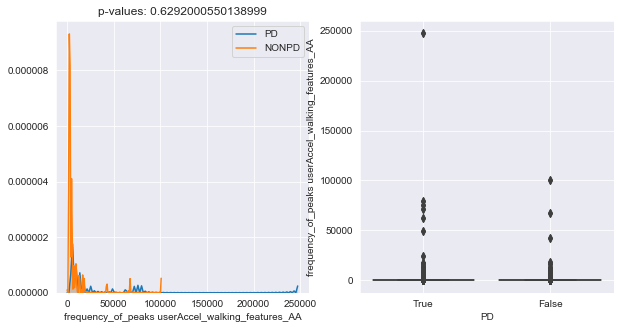

In [47]:
plot_distribution(walking_data[walking_data["gender"]== "Male"])

#### Analysis on Female Subjects

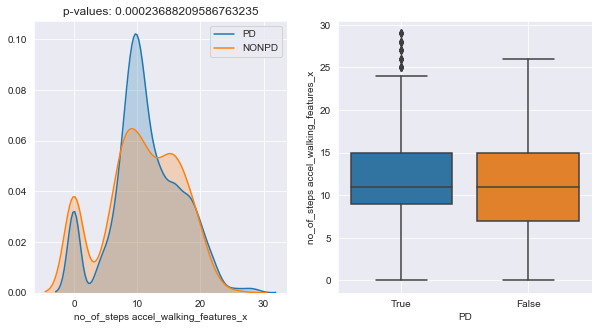

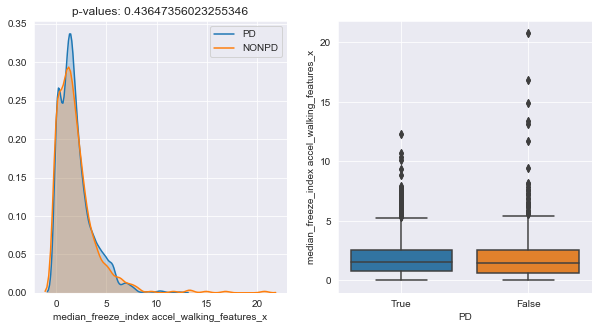

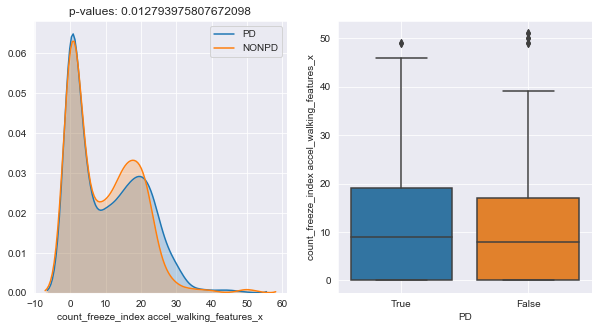

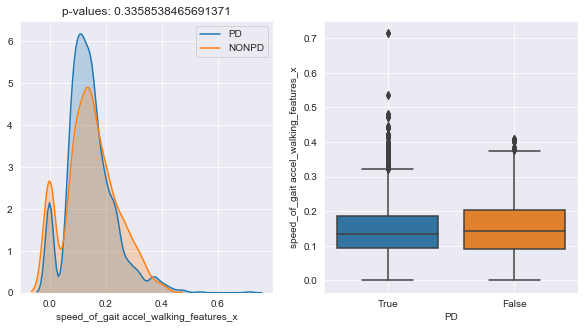

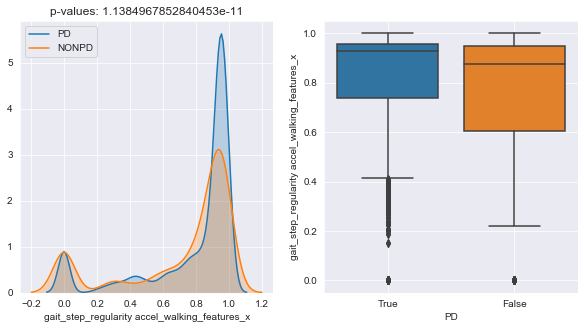

...

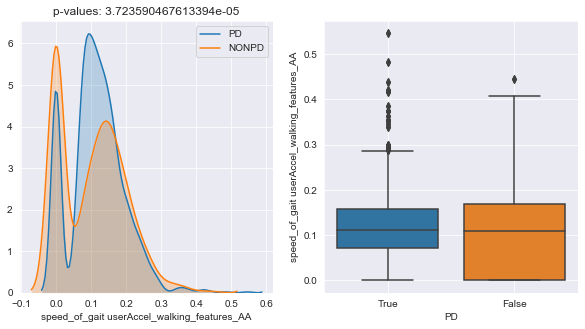

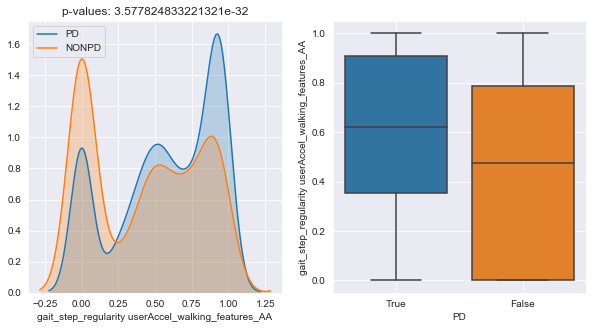

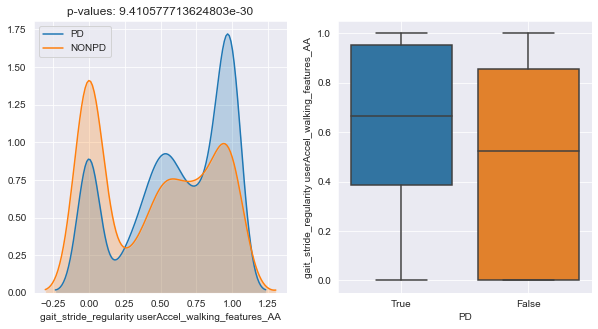

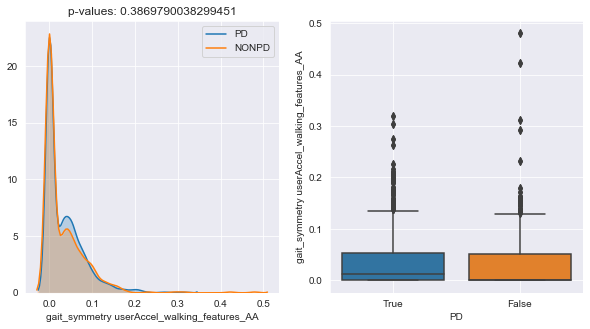

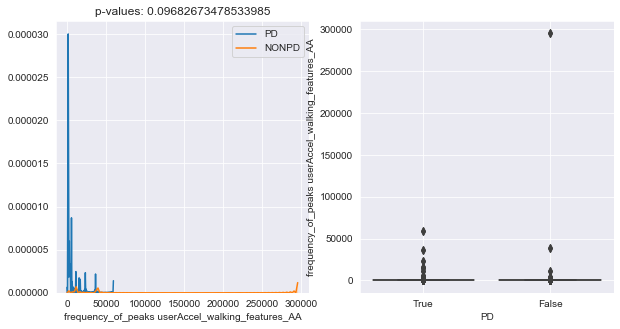

In [48]:
plot_distribution(walking_data[walking_data["gender"]== "Female"])

## 2. Balance Data All

#### Analysis on Males

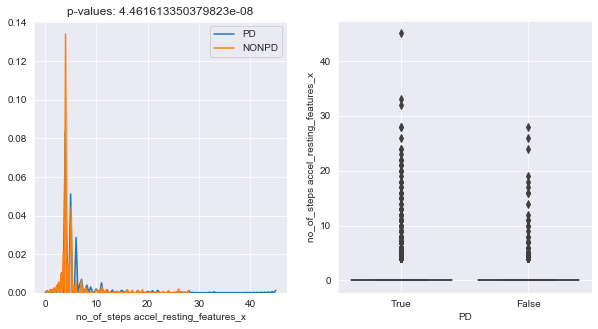

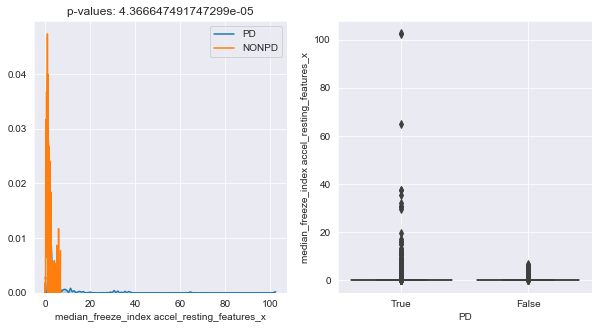

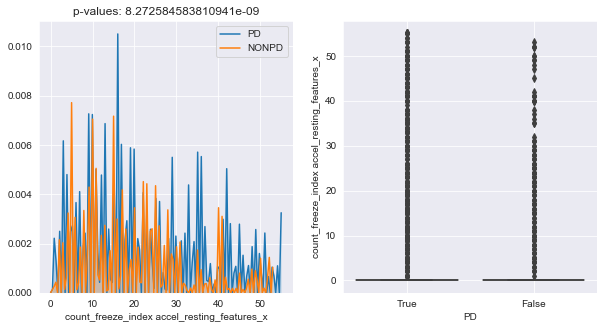

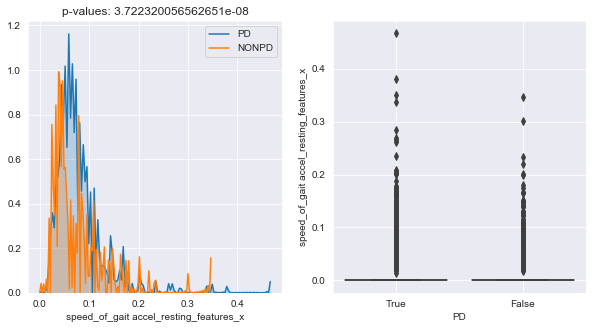

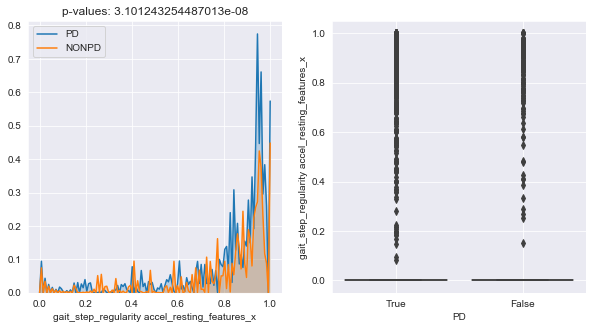

...

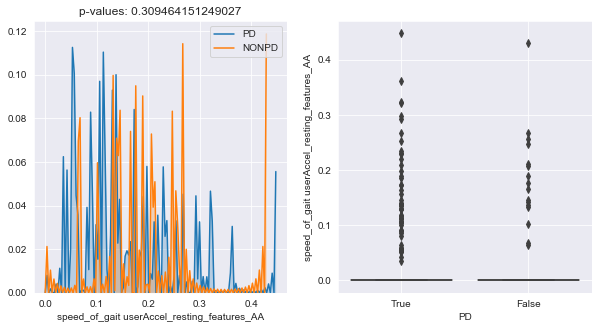

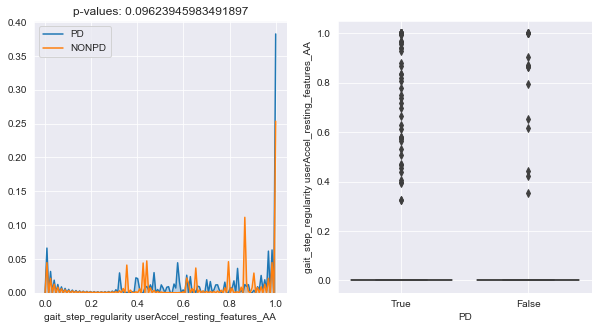

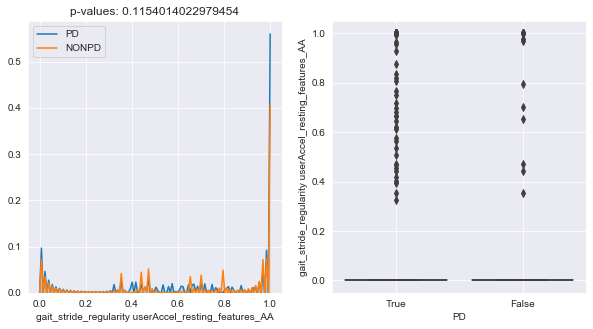

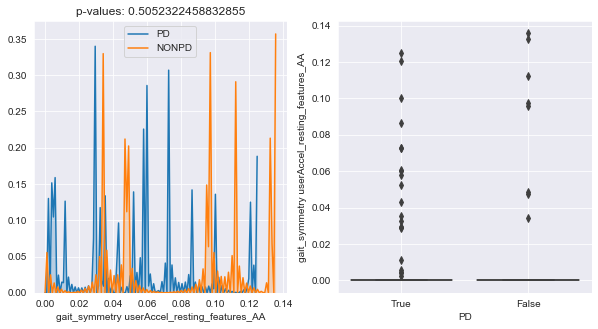

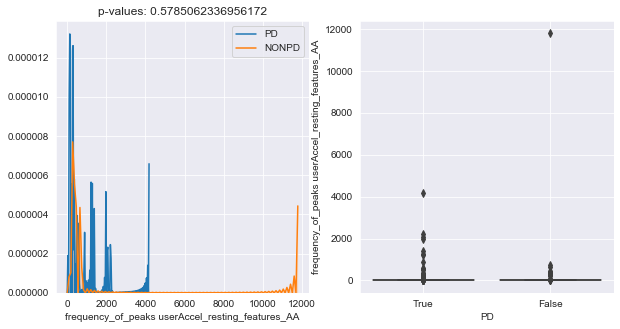

In [49]:
plot_distribution(balance_data[balance_data["gender"]== "Male"])

#### Analysis on Females

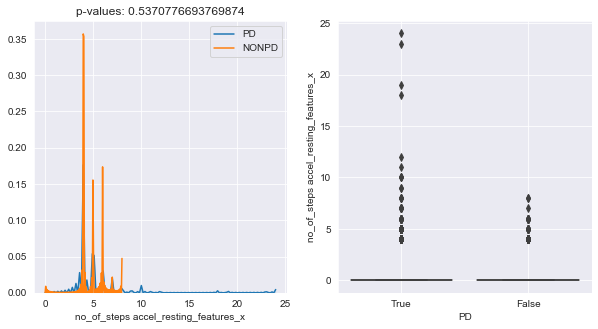

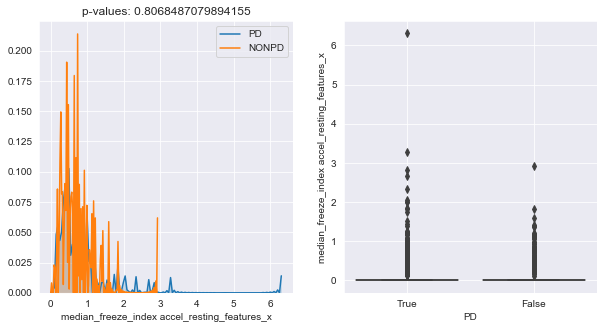

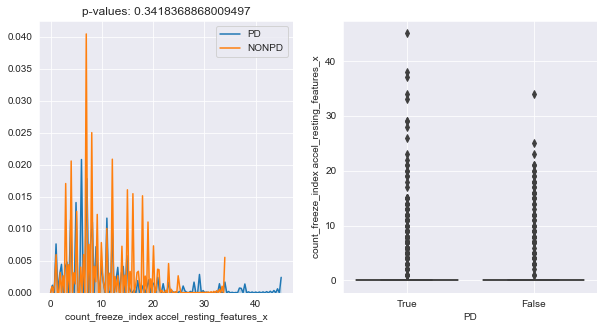

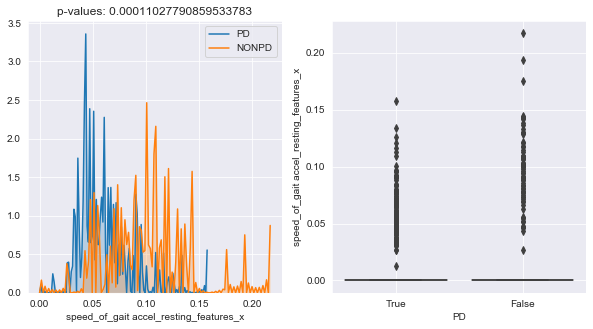

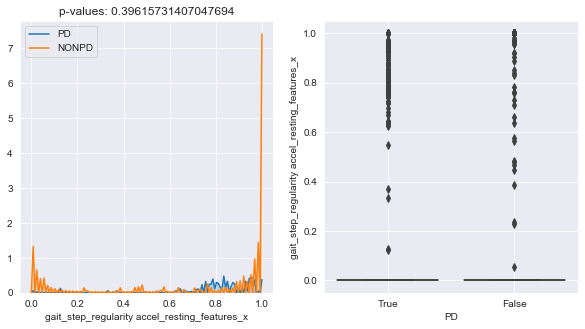

...

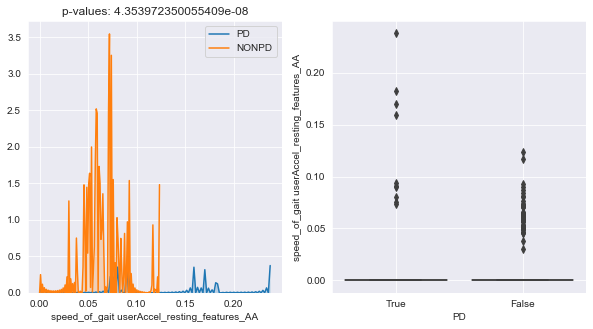

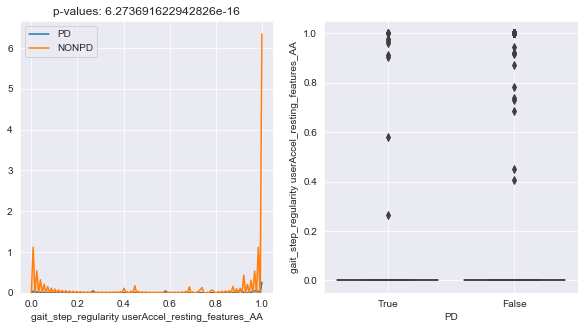

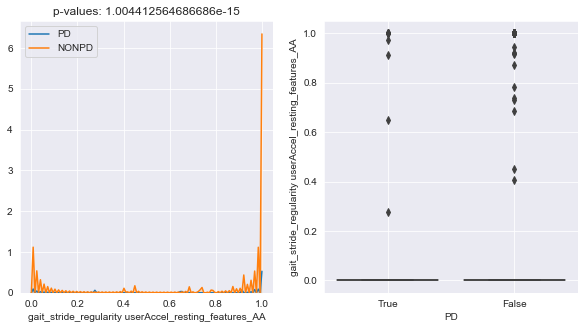

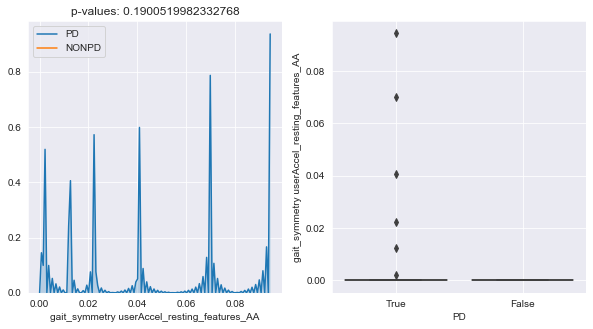

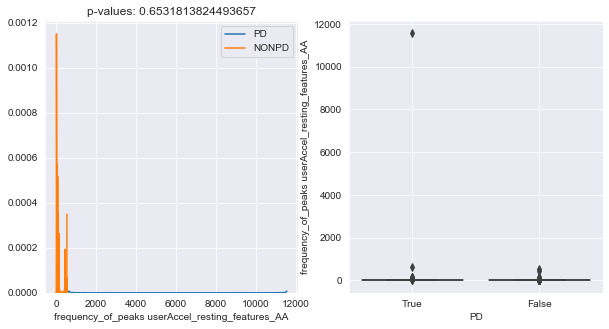

In [50]:
plot_distribution(balance_data[balance_data["gender"]== "Female"])

## 3. Analysis per HealthCode Data

In this section, it will analyze the features based on per healthcode summarized statistics. Balanced data is not used as most of the values are zero, further transformation on getting insights might be required.

## Walking Males Subject

In [62]:
data = walking_data[walking_data["gender"] == "Male"]
median_grouped_data = data.groupby("healthCode").median()
mean_grouped_data = data.groupby("healthCode").mean()
max_grouped_data = data.groupby("healthCode").max()
min_grouped_data = data.groupby("healthCode").min()
var_grouped_data = data.groupby("healthCode").var()

#### a. Grouped By Median

#### b. Grouped by Mean

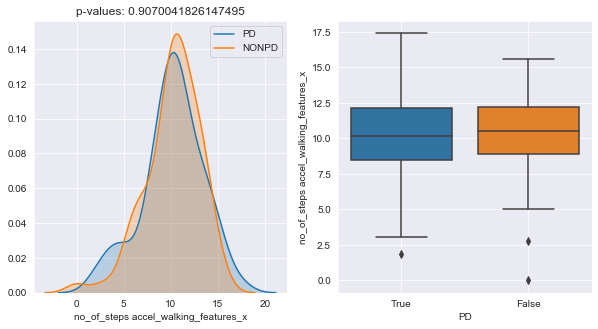

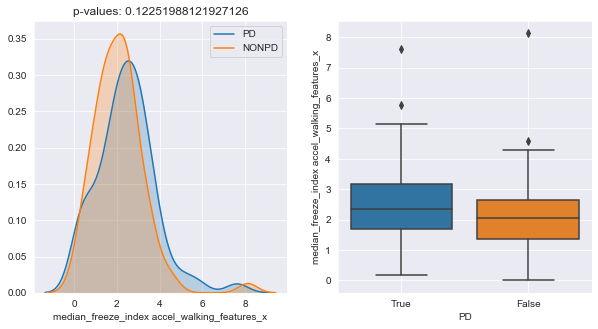

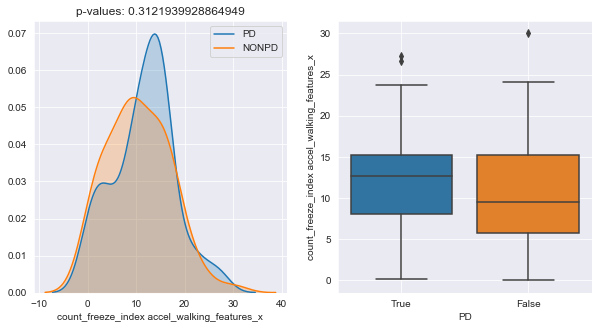

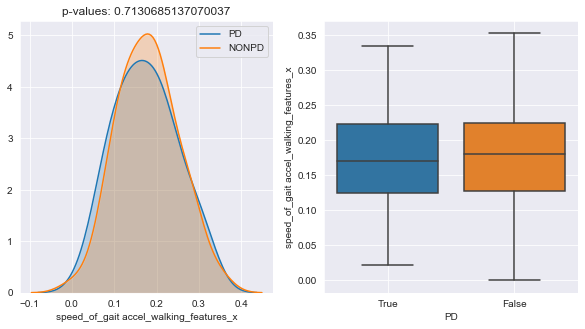

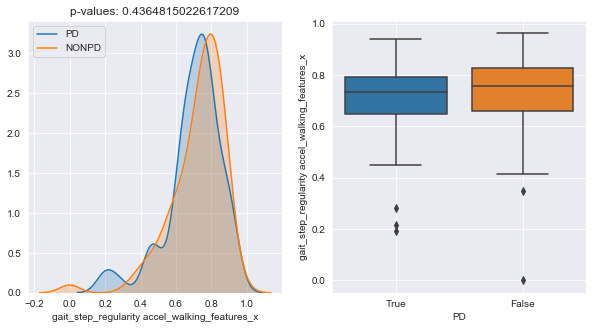

...

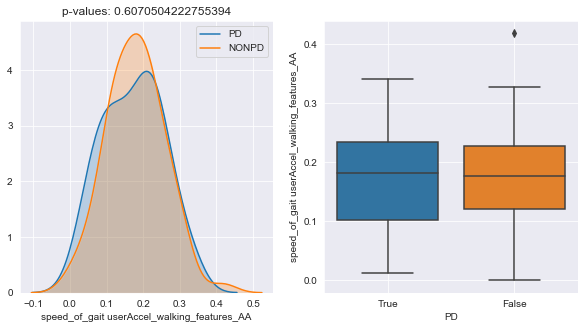

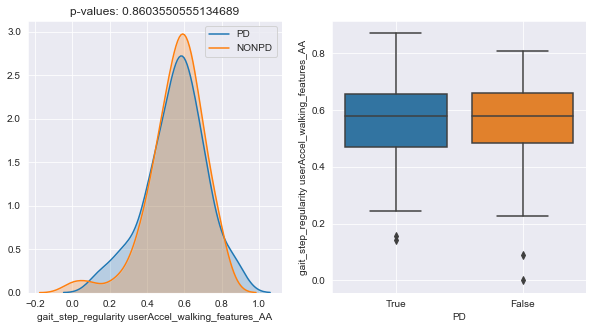

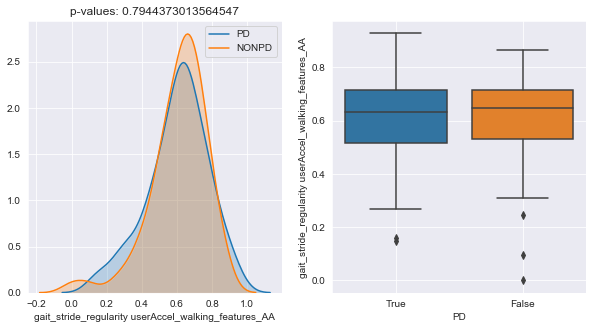

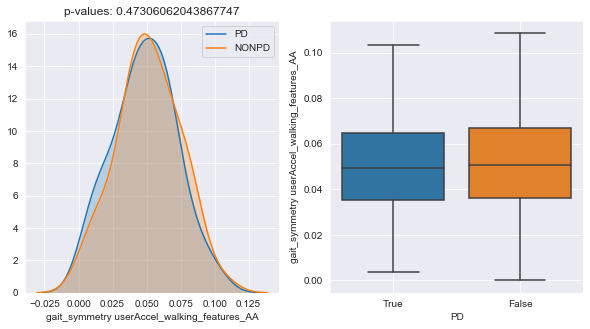

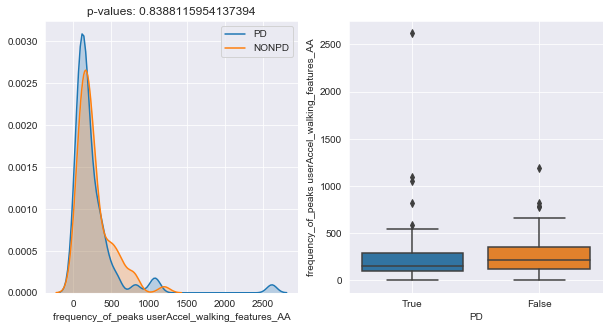

In [56]:
plot_distribution(mean_grouped_data)

#### c. Grouped by Max

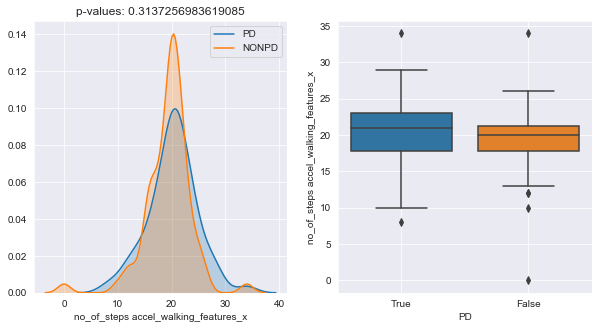

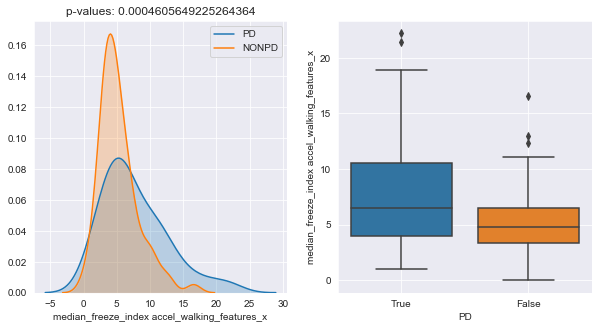

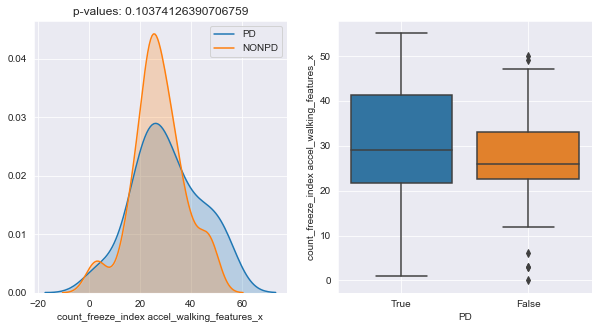

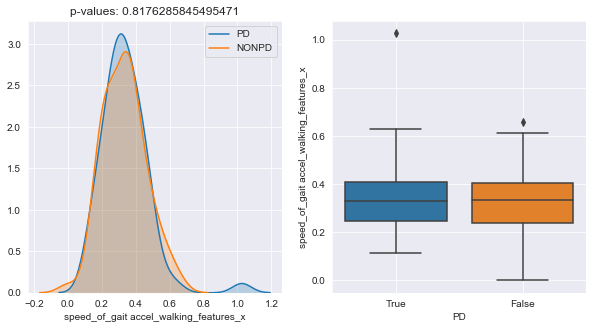

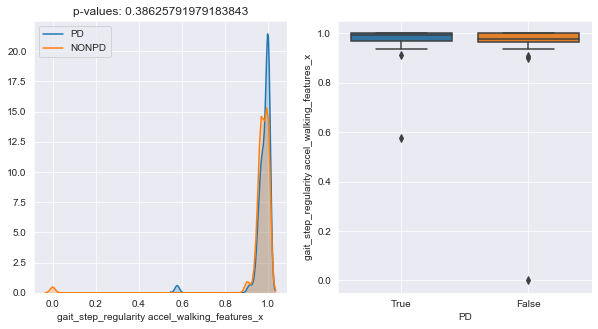

...

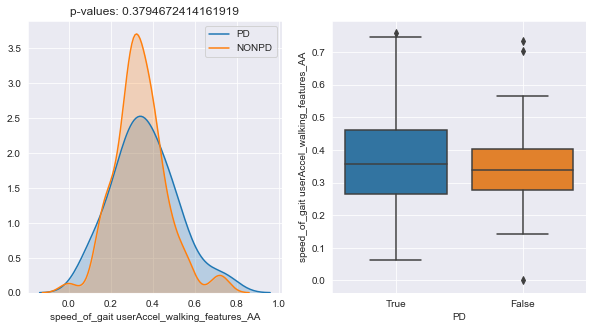

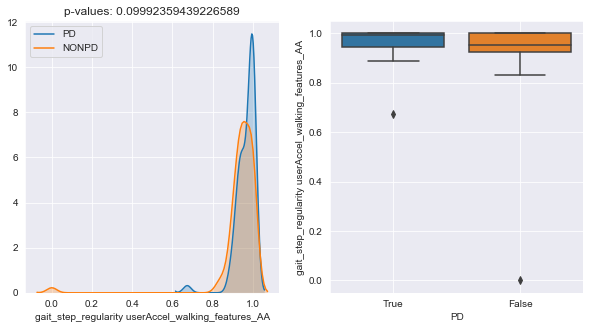

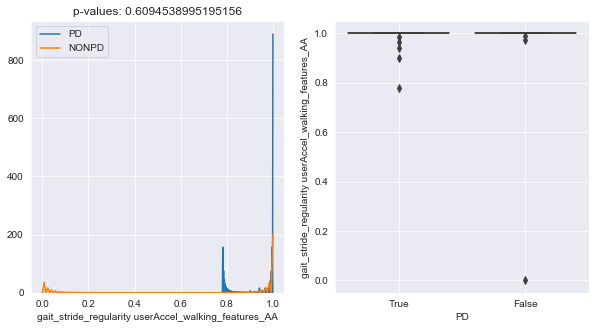

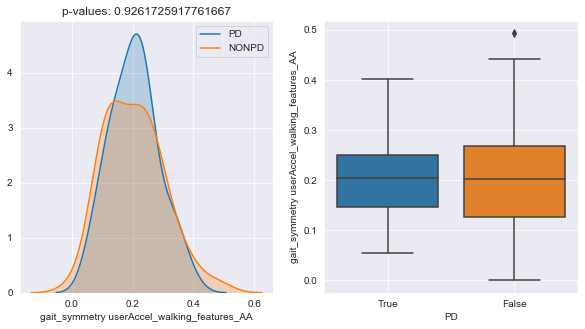

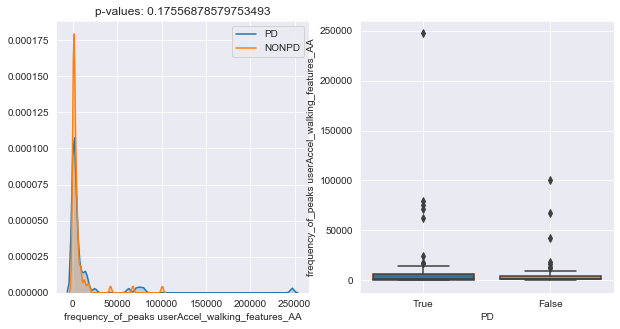

In [57]:
plot_distribution(max_grouped_data)

# Walking Females Subject

In [65]:
data = walking_data[walking_data["gender"] == "Female"]
median_grouped_data = data.groupby("healthCode").median()
mean_grouped_data = data.groupby("healthCode").mean()
max_grouped_data = data.groupby("healthCode").max()
min_grouped_data = data.groupby("healthCode").min()
var_grouped_data = data.groupby("healthCode").var()

#### a. Grouped By Median

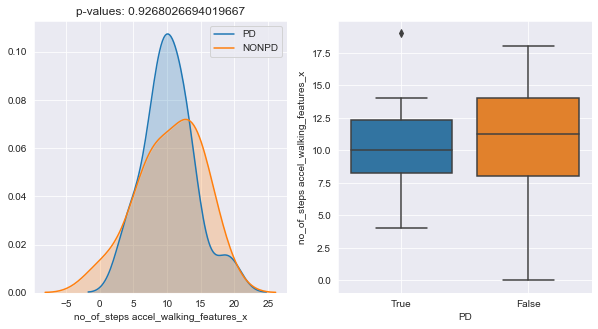

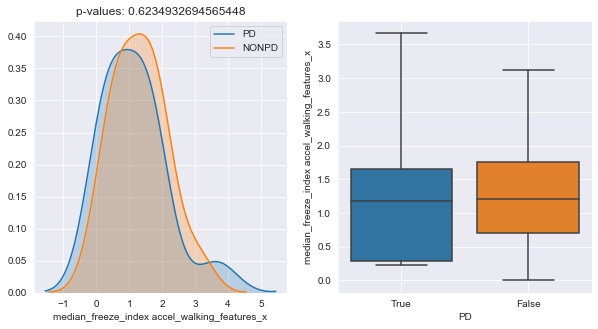

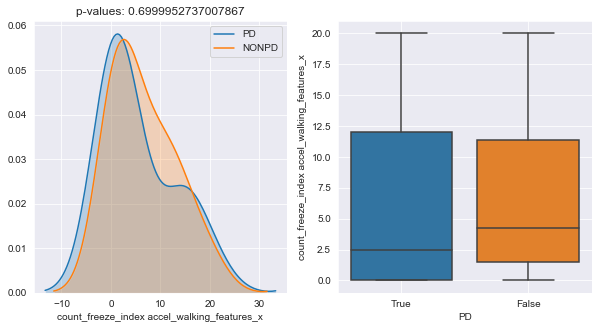

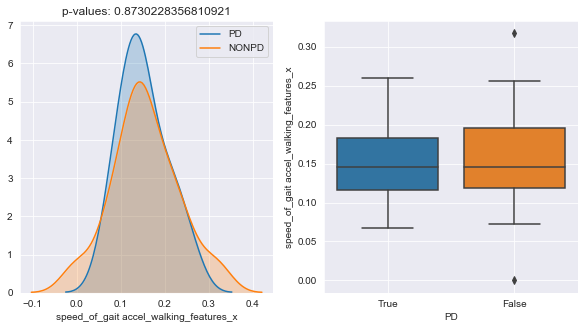

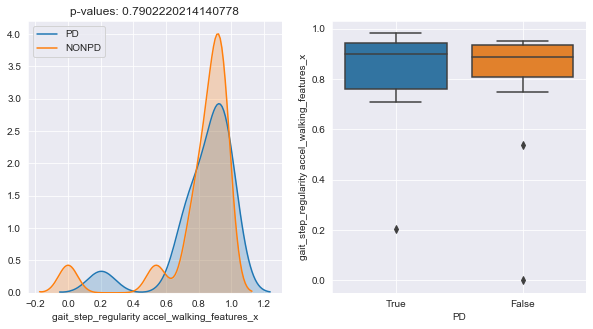

...

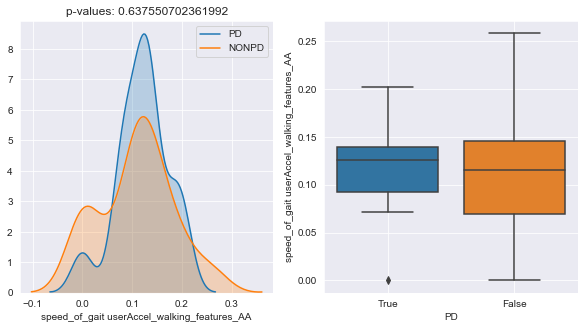

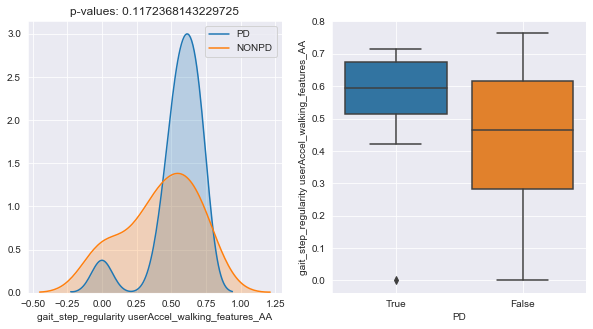

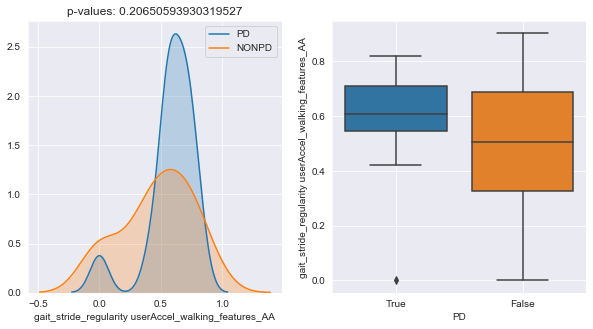

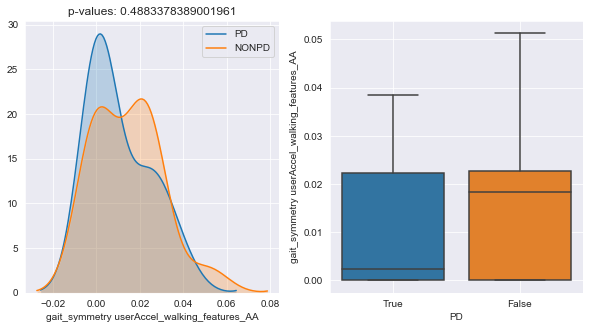

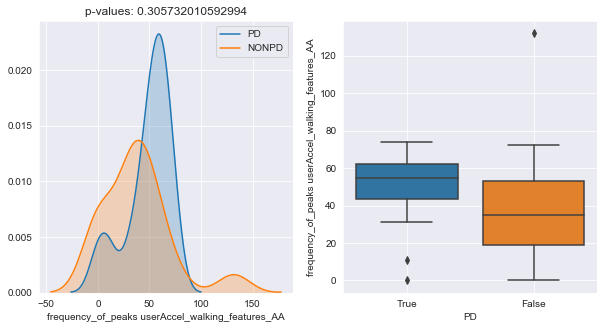

In [66]:
plot_distribution(median_grouped_data)

#### b. Grouped By Mean

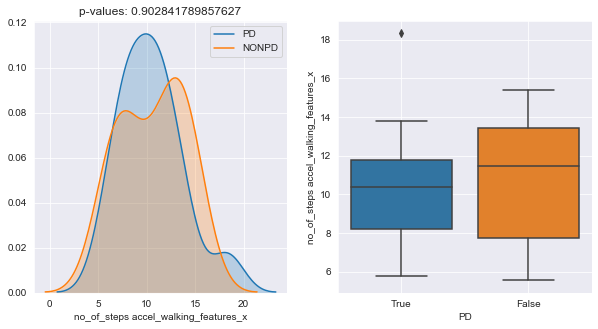

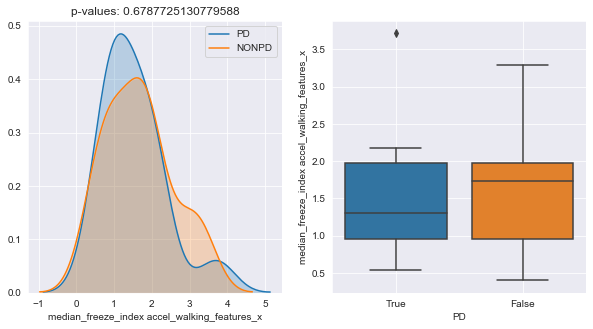

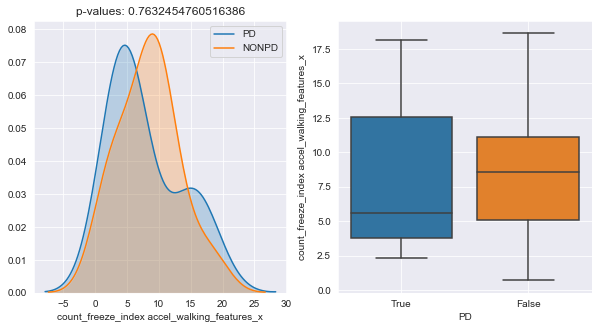

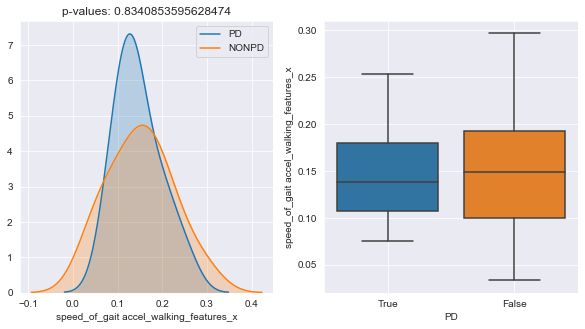

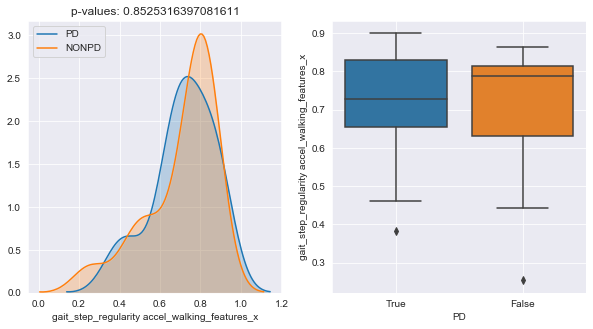

...

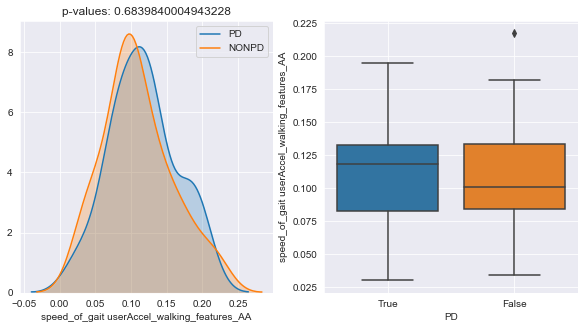

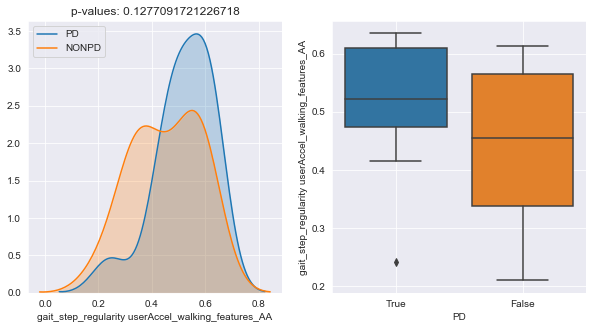

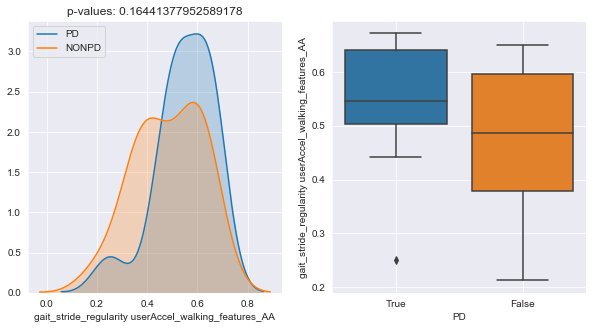

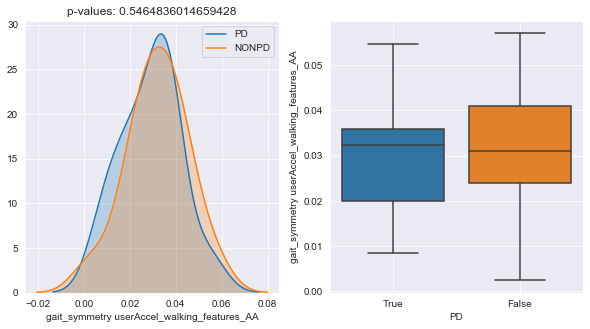

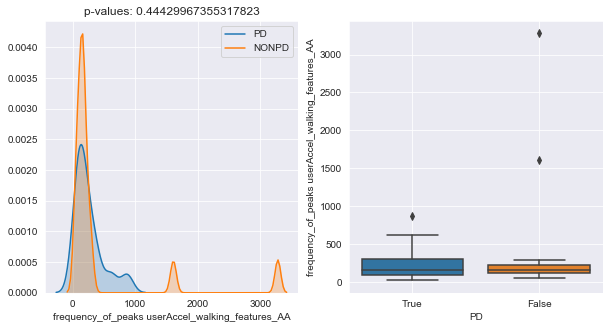

In [67]:
plot_distribution(mean_grouped_data)

#### c. Grouped By Max

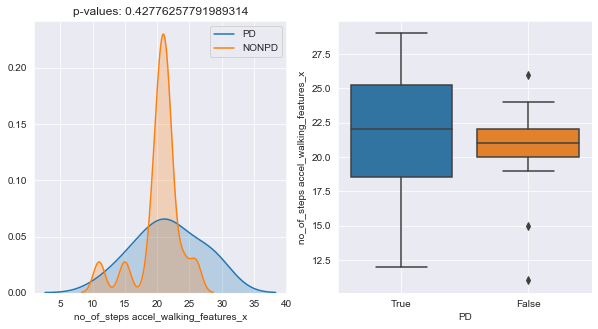

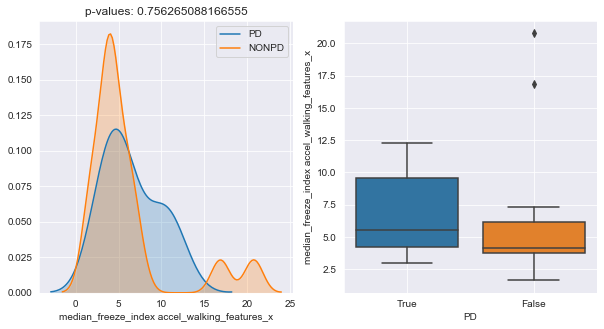

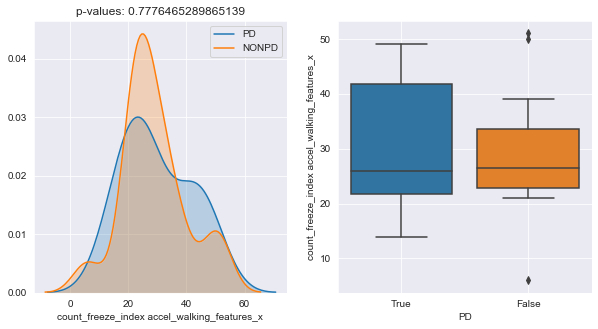

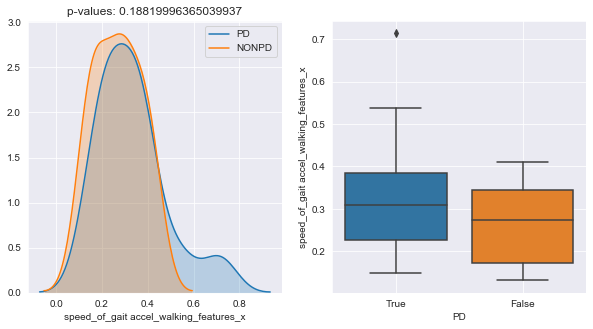

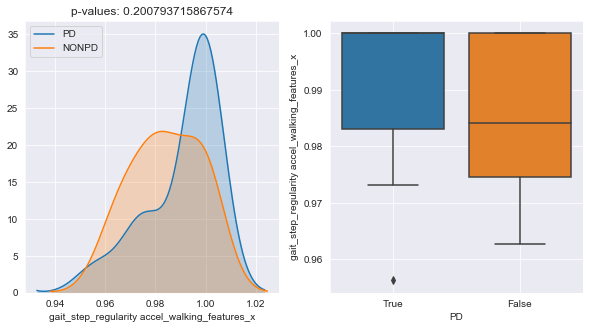

...

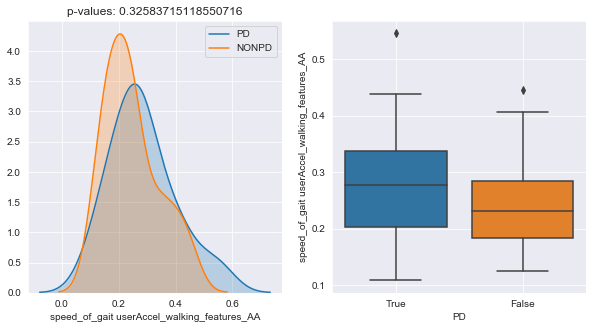

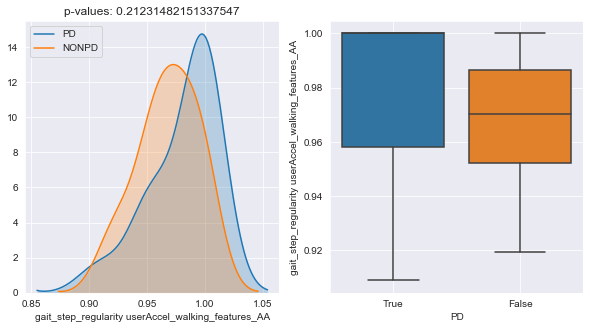

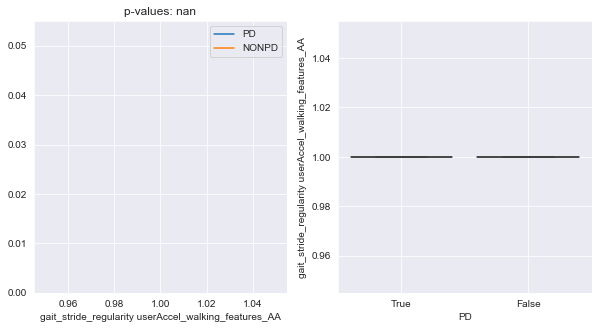

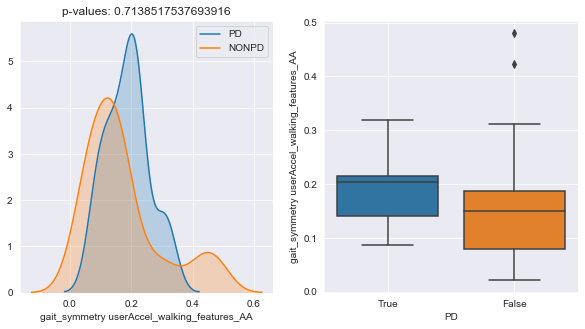

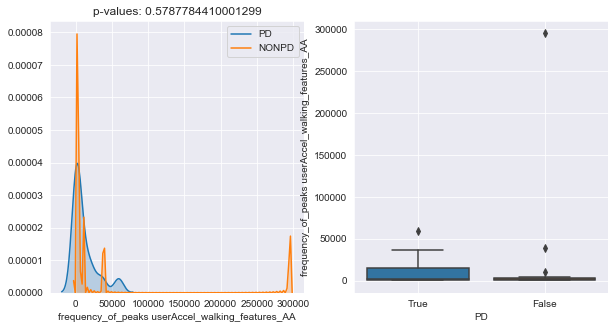

In [70]:
plot_distribution(max_grouped_data)